In [1]:
# Import Tensorflow 2.0
%tensorflow_version 2.x
import tensorflow as tf 

In [2]:
# # Download and import the MIT 6.S191 package
# !pip install mitdeeplearning
# import mitdeeplearning as mdl

     |████████████████████████████████| 2.1MB 2.9MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.1.2-cp36-none-any.whl size=2114585 sha256=768ffcf9bb03f0c7363f85e55aa1851a57e50c02dbf011fbf7725b5580285175
  Stored in directory: /root/.cache/pip/wheels/27/e1/73/5f01c787621d8a3c857f59876c79e304b9b64db9ff5bd61b74
Successfully built mitdeeplearning


In [3]:
# Import all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

In [4]:
# # Check that we are using a GPU, if not switch runtimes
# #   using Runtime > Change Runtime Type > GPU
# assert len(tf.config.list_physical_devices('GPU')) > 0

## Dataset

In [5]:
songs = mdl.lab1.load_training_data()

Found 816 songs in text


In [8]:
print(songs[0])

X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!


In [10]:
# Converting ABC Notation to audio file and listen it
mdl.lab1.play_song(songs[0])

In [16]:
# Join all song strings into single string containing all strings

songs_joined = "\n\n".join(songs)

In [18]:
# Find all the unique characters in the joined string

vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


## Process the Data

### Vectorize the text

Before we begin training our RNN model, we'll need to create a numerical representation of our text-based dataset. To do this, we'll generate two lookup tables: one that maps characters to numbers, and a second that maps numbers back to characters. Recall that we just identified the unique characters present in the text.

In [19]:
char2idx = {u:i for i, u in enumerate(vocab)}

In [20]:
idx2char = np.array(vocab)

In [29]:
# char2idx

In [30]:
print('{')

for char,_ in zip(char2idx, range(20)):
  print(' {:4s}: {:3d},'.format(repr(char), char2idx[char]))

print(' ...\n}')

{
 '\n':   0,
 ' ' :   1,
 '!' :   2,
 '"' :   3,
 '#' :   4,
 "'" :   5,
 '(' :   6,
 ')' :   7,
 ',' :   8,
 '-' :   9,
 '.' :  10,
 '/' :  11,
 '0' :  12,
 '1' :  13,
 '2' :  14,
 '3' :  15,
 '4' :  16,
 '5' :  17,
 '6' :  18,
 '7' :  19,
 ...
}


In [32]:
### Vectorize the songs string ###

def vectorize_string(string):
  vectorize_output = np.array([char2idx[char] for char in string])
  return vectorize_output


vectorized_songs = vectorize_string(songs_joined)

## Create Training Examples and Targets 

In [34]:
### Batch definition to create training examples ###

def get_batch(vectorized_songs, seq_length, batch_size):
  # length of the vectorized songs strings
  n = vectorized_songs.shape[0] - 1

  # randomly choose the starting indices for the examples in the training batch
  idx = np.random.choice(n-seq_length, batch_size)

  # Input Batch 
  input_batch = [vectorized_songs[i : i+seq_length] for i in idx]

  # Output Batch 
  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]

  # x_batch, y_batch provide the true inputs and targets for network training
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])

  return x_batch, y_batch

In [35]:
# Perform some simple tests to make sure your batch function is working properly! 
test_args = (vectorized_songs, 10, 2)


if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


In [36]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 60 ('e')
  expected output: 27 ('B')
Step   1
  input: 27 ('B')
  expected output: 59 ('d')
Step   2
  input: 59 ('d')
  expected output: 58 ('c')
Step   3
  input: 58 ('c')
  expected output: 1 (' ')
Step   4
  input: 1 (' ')
  expected output: 27 ('B')


## Modelling RNN

In [37]:
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

In [38]:
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Layer 1: Embedding layer to transform indices into dense vectors 
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    # Layer 2: LSTM with `rnn_units` number of units. 
    LSTM(rnn_units), 
    

    # Layer 3: Dense (fully-connected) layer that transforms the LSTM output
    #   into the vocabulary size. 
    tf.keras.layers.Dense(vocab_size)
  ])

  return model

In [40]:
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [41]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (32, None, 256)           21248     
_________________________________________________________________
lstm (LSTM)                  (32, None, 1024)          5246976   
_________________________________________________________________
dense (Dense)                (32, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [42]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)

In [43]:
pred = model(x)

In [44]:
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


### Predictions from the untrained model

Let's take a look at what our untrained model is predicting.

To get actual predictions from the model, we sample from the output distribution, which is defined by a `softmax` over our character vocabulary. This will give us actual character indices. This means we are using a [categorical distribution](https://en.wikipedia.org/wiki/Categorical_distribution) to sample over the example prediction. This gives a prediction of the next character (specifically its index) at each timestep.

Note here that we sample from this probability distribution, as opposed to simply taking the `argmax`, which can cause the model to get stuck in a loop.

Let's try this sampling out for the first example in the batch.

In [45]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([42, 66, 71, 42, 77, 60, 24, 18, 49, 66, 67, 72, 32, 35, 45, 75, 14,
        8, 29, 17, 62, 27, 67, 59,  4, 10, 65, 72, 25, 13, 14, 65, 18, 52,
       10, 29, 24, 31, 60, 18, 42, 28, 23, 78, 24,  4, 53, 56, 73, 62,  1,
       58, 32, 29, 81,  9, 25, 30, 21, 20, 32, 43, 55,  5, 13,  5, 14, 52,
       46, 81, 64, 80, 19, 69, 17, 28, 58, 10, 37, 52, 45, 70, 57,  7, 42,
       72, 63, 18, 11,  7, 14, 55, 67, 55, 47, 40, 56,  8, 56, 76])

In [46]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 ' g2g2|e2e2 f2fe|dfaf bgec|d2dc d2|]!\n\nX:18\nT:Madame Bonaparte\nZ: id:dc-setdance-19\nM:C|\nL:1/8\nK:A Ma'

Next Char Predictions: 
 "QkpQve=6XklqGJTt2,D5gBld#.jq>12j6[.D=Fe6QC<w=#]arg cGDz->E98GR_'1'2[Uziy7n5Cc.L[Tob)Qqh6/)2_l_VOa,au"


## Training Model

In [47]:
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss


example_batch_loss = compute_loss(y, pred)

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.419667


In [48]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 2000  # Increase this to train longer
batch_size = 4  # Experiment between 1 and 64
seq_length = 100  # Experiment between 50 and 500
learning_rate = 5e-3  # Experiment between 1e-5 and 1e-1

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 1024  # Experiment between 1 and 2048

# Checkpoint location: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

In [49]:
### Define optimizer and training operation ###

model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

optimizer = tf.keras.optimizers.Adam(learning_rate)

In [50]:
@tf.function
def train_step(x, y): 
  # Use tf.GradientTape()
  with tf.GradientTape() as tape:
    y_hat = model(x) 

    loss = compute_loss(y, y_hat)

  # Now, compute the gradients 
  grads = tape.gradient(loss, model.trainable_variables) # TODO
  
  # Apply the gradients to the optimizer so it can update the model accordingly
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  
  return loss

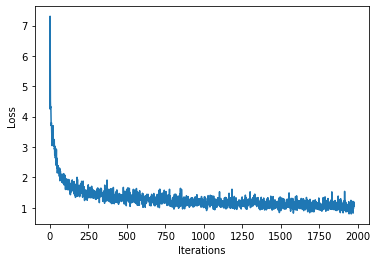

100%|██████████| 2000/2000 [03:18<00:00, 10.08it/s]


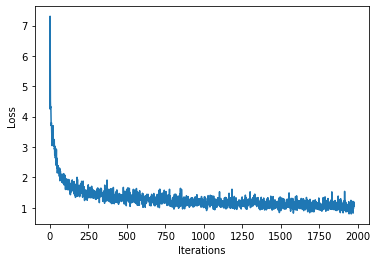

In [51]:
## Begin Training

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Update the model with the changed weights!
  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)
    
# Save the trained model and the weights
model.save_weights(checkpoint_prefix)


## Generate Music

In [52]:
# Restore the latest checkpoint

model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
lstm_2 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_2 (Dense)              (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [53]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)
  input_eval = [char2idx[s] for s in start_string] 

  input_eval = tf.expand_dims(input_eval, 0)

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      '''evaluate the inputs and generate the next character predictions'''
      predictions = model(input_eval)

      
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0)
      
      '''use a multinomial distribution to sample'''
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()

      
      # Pass the prediction along with the previous hidden state
      #   as the next inputs to the model
      input_eval = tf.expand_dims([predicted_id], 0)
      
      '''add the predicted character to the generated text!'''
      text_generated.append(idx2char[predicted_id]) 
    
  return (start_string + ''.join(text_generated))

In [54]:
generated_text = generate_text(model, start_string="X", generation_length=1000)

100%|██████████| 1000/1000 [00:06<00:00, 154.49it/s]


In [55]:
### Play back generated songs ###

generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it! 
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 4 songs in text
Generated song 0


Generated song 1


Generated song 2


Generated song 3


Consider how you may improve your model and what seems to be most important in terms of performance. Here are some ideas to get you started:

*  How does the number of training epochs affect the performance?
*  What if you alter or augment the dataset? 
*  Does the choice of start string significantly affect the result? 